**Objectifs**
  - Proposer une méthode heuristique pour trouver une solution approchée d'un problème.
  - Résoudre un problème en recherche opérationnelle par des techniques probabilistes.
  - Présenter une des applications des chaînes de Markov.

# Voyegeur du commerce



In [1]:
%%html
<iframe src="https://fr.wikipedia.org/wiki/Probl%C3%A8me_du_voyageur_de_commerce?oldformat=true" width="1300" height="300"></iframe>

# I- Modélisation 

## Graphes, circuits et permutations

Le voyegeur du commerce veut faire un tour optimal passant une fois et une seule fois en $M$ villes $V_1,...,V_M$, en partant et en revenant d'une ville distincte $V_0$. L'optimalité étant comprise
au sens de la distance ou du temps ou l'energie, etc.

On se place dans le cadre général où toute paire de villes est liée par une route. Dans ce cadre, le problème pourra être modélisé par $G=(V,A)$ un graphe non orienté complet dont les sommets sont les villes $V_0,\dots,V_M$ et les arêtes sont les routes liants ces villes pondérées des coûts de voyage. Le problème du voyegeur du commerce est donc celui de trouver la chaîne fermée d'origine/ $V_0$ qui passe par tous les sommets de $G$ tout en minimisant le coût du voyage.

Le graphe étant complet, une autre approche de modélisation est celle avec les permutation "bijections" de l'ensemble $\{1,\dots,M\}$. Un cicruit peut être représenté par une permutation $\sigma $ de $\{1,...,M\}$: 

On part de $V_0$, on visite $V_{\sigma(1)}$, puis $V_{\sigma(2)}$,..., jusqu'à $V_{\sigma(M)}$, et en retourne à $V_0$. 

$$
V_0 \longrightarrow V_{\sigma(1)} \longrightarrow V_{\sigma(2)} \longrightarrow \dots \longrightarrow V_{\sigma(M)} \longrightarrow V_0  
$$
  


L'ensemble de tous les cicuits possibles sera donc identifié avec $\cal P_M$ l'ensembe des permutatins de $\{1,\dots,M\}$, montrant au passage qu'il y a exactement $M!$ cicuits possibles






<figure>

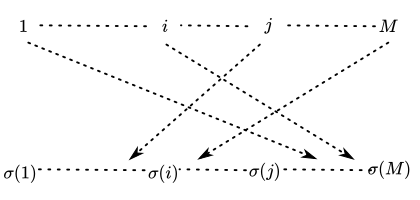

<figcaption style='magrin:auto ;text-align: center;'> <b> une permutation de $\{1,\dots,M\}$</b> </figcaption>
</figure>

Sans perte de généralité, on suppose que $V_0,V_1,...,V_M \in {\mathbb R}^d$ avec $d\geq1$ et que le coût d'aller d'une ville à une autre est refleté par la distance euclidienne. La distance parcourue d'un circuit donné, associée avec la permutation $x \in {\cal P_M}$ est donc donnée par 
$$
f(x) = \sum_{i=0}^M \| V_{x(i+1)} - V_{x(i)} \|_2,
$$
où on a rajouté comme notation $x(0)=x(M+1)=0$, $f$ définit donc une fonction de ${\cal P}_M$ dans ${\mathbb R}^+$

$$
x \in {\cal P}_M \mapsto f(x) \in {\mathbb R}^+ 
$$

La fonctin $f$ est discrete et prend au plus $M!$ valeurs. Toutefois, notons que $M!$ croit très rapidement ($M! > (M/e)^M$), donc l'optimisatin par "simple" recherche exhaustive peux s'averér impraticable  

In [2]:
import math 
print ("20!=", math.factorial (20))
## même si on teste un milliards de tours par seconde, tester tous les tours 
## nous prendra plus que 76 années 
math.factorial (20)/ (10**9 * 3600 *24 * 366)


20!= 2432902008176640000


76.9360329442623

## Circuits modifiés

Etant donné un cicruit identifié à un $x \in \cal P_M$, on va appeler $V_{x (1)}$ le 1er arrêt, $V_{x (2)}$ le 2ème arrêt, etc. Plusieurs stratégies sont possibles pour légèrement modifier $x$ afin de potentiellement réduire la distance parcourue. Par exemple:

- stratégie 1: permuter l'ordre des arrêts en $V_{x(i)}$ et $V_{x(j)}$ pour $i\neq j$.
- stratégie 2: inverser l'ordre de passages entre $V_{x(i)}$ et $V_{x(j)}$ avec $i\neq j$.
- stratégie 3: reporter l'arrêt en $V_{x(i)}$ à un temps futur $j>i$.
- stratégie 4: anticiper l'arrêt en $V_{x(j)}$ à un temps antérieur $i<j$.
- etc


Les stratégies expliquées plus haut correspondent à des modifications (transformations) appliquées à la permutation $x$ encodant le circuit. Plus précisement 

$$
S_{ij} :x \in {\cal P}_M \to y \in {\cal P}_M
$$

avec

- stratégie 1: $x=y$ sur $\{1,\dots,M\}-\{i,j\}$, sinon
$y(i)  = x(j),~y(j)  = x(i)$. (sera implémenté)

- stratégie 2: $x=y$ sur $\{1,\dots,M\}-\{i,\dots,j\}$,
$y(i)  = x(j)$, $y(i+1)=x(j-1)$,...,$y(j)  = x(i)$.(sera implémenté)


- stratégie 3: $x=y$ sur $\{1,\dots,M\} - \{i,\dots,j\}$,
$y(i)  = x(i+1),\dots,y(j-1)= x(j)$, et $y(j) = x(i)$.(voir bonus) 

- stratégie 4: $x=y$ sur $\{1,\dots,M\} - \{i,\dots,j\}$,
$y(i) = x(j)$ et $y(i+1)  = x(i),\dots,y(j)  = x(j-1)$.(voir bonus)


**Stratégie 1**

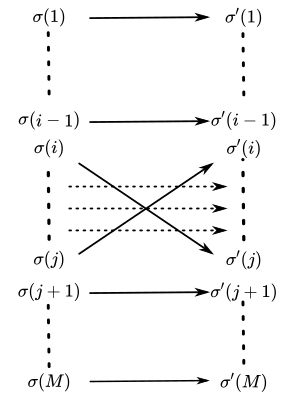


**Stratégie 2**

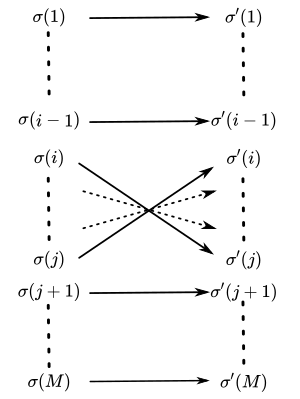

> ### **Question** **???**: 
on peut toujours passer d'une permutation $x_0$ à une autre $x_\infty$ quelconques par une succession de ces opérations. Expliquez rapidement pourquoi ? 

## Voisinages

On définit les relations $\sim_1$, $\sim_2$, où $y \sim_k x$ si $y$ est transformée de $x$ par stratégie $k$. On définit un voisinage de $x \in {\cal P}_M$ comme étant l'ensemble de tous les $y$ qui peuvent être transformée de $x$ par stratégie $k$.    

$$
{\mathcal B}_{k}(x) = \{ y \in {\mathcal P}_M: y \sim_i x \}
$$

> ### **Question** : **???**
Quel est le nombre de voisins de $x \in {\cal P}_M$ pour chaque relation 
$$
\#({\cal B}_{1}(x)) = M(M-1) / 2,\quad\quad\quad\quad
\#({\cal B}_{2}(x)) = ?.
$$
</div>

## Calcul de Voisins

Par souci de simplicité, on va implémenter les permutations comme simple tableaux de python (list en terminologie python) de longeur $M$. Notons que les operations de voisinages décrites plus haut s'appliques à tout tableau.

La fonction swap qui échange (permute) deux éléments d'un tableau aux positions $i$ et $j$ est donnée à titre indicatif

Compléter la fonction reverse qui implémente la stratégie 2 

In [3]:
## x is a python list or a numpy array of lenght n, 
## x = x[0] x[1] ... x[i]... x[j] ... x[n-1]
## i and j are indices as described in the strategies. 

def swap(x,i,j):
    ## assert i and j are valid indices, i.e. in {0,1,...,M-1}
    M=len(x)
    assert (i in range(M) and j in range(M))   
    ## swap x[i] and x[j] 
    x[i], x[j] = x[j], x[i] 
    
def reverse(x,i,j):
    ## assert i and j are in {0,1,...,M-1} and
    M=len(x)
    assert (i in range(M) and j in range(M))
    ## reverse the range x[i],...,x[j] 
    if j<i: 
        reverse (x,j,i)
        return 
    else:
        x[i:j+1] = x[j:i-1:-1]

In [4]:
print ('swap') 

x = [1,3,4,5,7,6,8]
swap (x,4,2)
print ('expected result', [1, 3, 7, 5, 4, 6, 8] )
print ('returned result', x )
 
print ('reverse') 

x = [1,3,4,5,7,6,8]
reverse (x,2,4)
print ('expected result', [1, 3, 7, 5, 4, 6, 8])
print ('returned result', x )

swap
expected result [1, 3, 7, 5, 4, 6, 8]
returned result [1, 3, 7, 5, 4, 6, 8]
reverse
expected result [1, 3, 7, 5, 4, 6, 8]
returned result [1, 3, 7, 5, 4, 6, 8]


> ### **Question** 
Ecrire les fonctions "swap_copy" et "reverse_copy" qui implémente les strategies 1 et 2 pour x tableau et indices i et j. On renvoie un nouveau y et on modifie pas x. 

In [5]:
## indication, utiliser la fonction copy de numpy 
def swap_copy(x,i,j):
    y = x.copy()
    swap(y,i,j)
    return y

def reverse_copy(x,i,j):
    y = x.copy()
    reverse(y,i,j)
    return y
        

In [6]:
print ('swap') 

x = [1,3,4,5,7,6,8]
y = swap_copy(x,4,2)
print ('expected result', [1, 3, 7, 5, 4, 6, 8] )
print ('returned result', y )
 
print ('reverse') 

x = [1,3,4,5,7,6,8]
y = reverse_copy(x,2,4)
print ('expected result', [1, 3, 7, 5, 4, 6, 8])
print ('returned result', y )

swap
expected result [1, 3, 7, 5, 4, 6, 8]
returned result [1, 3, 7, 5, 4, 6, 8]
reverse
expected result [1, 3, 7, 5, 4, 6, 8]
returned result [1, 3, 7, 5, 4, 6, 8]


# Algorithme d'optimisation

On voudrait construire des suites $(X_n)_{n\geq0}$ de permutations de $\{1,\dots,M\}$ d'une manière itérative de telle façon $(f(X_n))_{n\geq0}$ tends vers le minimum de $f$ sur ${\cal P}_M$. 


## Heurtistique d'un algorithme probabiliste

On construit la suite $(X_n)_{n\geq0}$ de permutations de $\{1,\dots,M\}$ de la façon suivante:

- **Initialisation**: (voir plus bas)
    
    
- **Etape $n$**: à cette étape $X_n=x$. On choisit de manière aléatoire (uniforme) un voisin $y$ de $x$. On calcule la valeur de $f(y)$, et on la compare à celle de $f(x)$
    - si $f(y)< f(x)$, alors $y$ est meilleur que $x$, on va donc remplacer $x$ par $y$, soit
    $$
    X_{n+1} = y.
    $$
    - si $f(y) \geq f(x)$, alors $x$ reste meilleur, et on va donc le garder, soit 
    $$
    X_{n+1} = x.
    $$
    


- **Critère d'arrêt**: (voir plus bas) 

> ### **Question**
Expliquer pourquoi cet algorithme pourrait ne pas converger vers le minimum global de $f$.

> **Answer**: cet algorithm pourra rester coincé dans un minimum local, car une fois un minimum et atteint il n'y as aucun incentive pour explorer d'autre x.

# II-Recuit simulé

L'approche de l'algorithme ci-dessus risque de ne pas converger. En effet si $X_n = x$ et $f(x) \leq f(y)$ pour tout voisin $y$ de $x$, alors l'algorithme restera coincé en $X_n$ et ne fait plus améliorer l'optimisation après l'itération $n$. Dans ce cas, $X_n$ est un minimum local par rapport au voisinage choisi. Pour éviter de rester coincé dans un minimum local, on va modifier l'étape $n$ de l'algorithme comme ceci: lorsque $f(y) > f(x)$, on va parfois changer et prendre $y$, et ceci d'autant plus que l'écart entre $f(x)$ et $f(y)$ est faible. 

Une manière d'implémenter cela est d'utiliser la méthode de «recuit simulé». Le principe est le suivant : on suppose que l'on a une température $T$, et pour chaque étape, comme précédemment, on tire au sort un voisin $y$ de $X_n$, et on regarde si le circuit $y$ améliore le critère $f$,

- si oui, on effectue le remplacement ;
- sinon, la distance totale du circuit augmente. Si l'on note $\Delta f = f(y) - f(x)$ cette augmentation, alors on effectue l'échange avec une probabilité
$$
e^{- \frac {\Delta f} T } \in ]0,1[
$$
Pour cela, on simule une loi uniforme $U_{n+1}$ sur $]0,1[$. Si $U_{n+1} \leq  e^{- \frac {\Delta f}T }$, on effectue l'échange.

On reprend l'algorithme plus haut avec la nouvelle modification 


Voir aussi:

- https://en.wikipedia.org/wiki/Simulated_annealing?oldformat=true
- https://professeurb.github.io/ipt/spe/voyageur/


## Algorithme

On construit la suite $(X_n)_{n\geq0}$ de permutations de $\{1,\dots,M\}$ de la façon suivante:

- **Initialisation**: on chosisit de manière déterministe ou arbitraire la permutation de départ $X_0$, e.g. 

    - la permutation identité; $X_0(j)=j$ pour tout $j \in \{1,\dots,M\}$.
    - la permutation $X_0$ choisie de manière aléatoire dans ${\cal P}_M$ (probabilité uniforme).
    - la permutation $X_0$ calculée par heuristique de Christophide (voir bonus)


- **Etape $n$**: à cette étape $X_n=x$. On choisit de manière aléatoire (uniforme) un voisin $y$ de $x$. On calcule la valeur de $f(y)$, et on la compare à celle de f(x)

    - si $f(y)< f(x)$, alors $y$ est meilleur que $x$, on va donc remplacer $x$ pour garder 
    $y$, soit
    $$
    X_{n+1} = y.
    $$
    - si $f(y) \geq f(x)$, alors $x$ reste meilleur. On tire au hasard $U_{n+1}$ de loi uniforme  sur $]0,1[$ 
    (indépendante de $y$) et on pose

$$
X_{n+1} =  \left\{ \begin{array}{l} y \quad\mbox{  si } f(y) \leq f(x) - T \log(U_{n+1}),\\ x \quad \mbox{  sinon}. \end{array} \right.  
$$
    
- **Critère d'arrêt**: on s'arrête à l'itération $N$, avec $N$ propre à l'utilisateur 


> ### **Question**
Compléter l'implémentation de l'algorithme  

### Implémentation du calcul de $f$

In [7]:
import numpy as np

def distance (Vi,Vj):
    return np.linalg.norm( Vi - Vj)

def circuit_distance (V0, V, x): ## V = V1 V2 ... VM
    ## distance de V0 --> Vx[0]--> .... --> Vx[M-1] --> V0
    M = len (x)
    result= distance(V0, V[x[0]]) + distance(V[x[M-1]], V0)  ## distance  V0 --> Vx[0] + Vx[M-1] --> V0     
    for k in range(M-1):
        result += distance(V[x[k]], V[x[k+1]]) ## autres distances
    return result


### Implémentation du choix aléatoire d'un voisin

In [8]:
## indication np.random.rantint
def random_swap(x):
    M = len(x)
    i = np.random.randint(0, M) ## chosir aleatoirement i 
    j = np.random.randint(0, M) ## chosir aleatoirement j, ne par tirer j=i
    while i == j:
        j = np.random.randint(0, M)
    return swap_copy(x,i,j)

def random_reverse(x):
    M = len (x)
    i = np.random.randint(0, M) ## chosir aleatoirement i 
    j = np.random.randint(0, M) ## chosir aleatoirement j, ne par tirer j=i
    while i == j:
        j = np.random.randint(0, M)
    return reverse_copy (x,i,j)    

## Implémentation de l'algorithme 

In [9]:
## Pour strtegie 1 ou 2
def algorithm0(V0, V, N, Temperature):
    assert (Temperature>0)
    M = len(V) 
    x = np.arange(M) ## permutation initiale (identité)
    min_dist = circuit_distance(V0, V, x) ## distance du circuit initiale
    print ("initial distance = ", min_dist)
    print ("initial order of V = ", [Vi for Vi in V[x]])
    n = 1
    while(n < N):
        y = random_swap(x)
        new_dist = circuit_distance(V0, V, y)
        diff_dist = new_dist - min_dist
        #print ("-----------")
        U = np.random.uniform(0.00001)
        if diff_dist < 0 or (diff_dist >= 0 and diff_dist <= -Temperature*np.log(U)): ## compléter ici 
            x=y
            min_dist = new_dist 
            print (x,"\t -->",min_dist)        
        n = n+1
          
    print ("current order of V = ", [Vi for Vi in V[x]])
    return x

## Test avec quelques villes

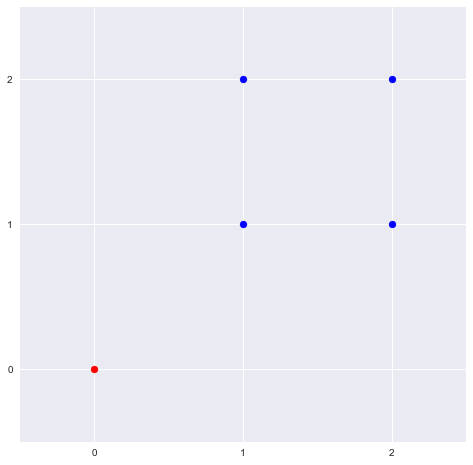

In [10]:
V0 = np.array ([0,0])
V  = np.array ([[1,1], [1,2], [2,1], [2,2]])

%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn')

plt.figure(figsize=(8,8)) 
plt.axes(xlim=(-0.5, 2.5), ylim=(-0.5, 2.5))
plt.xticks([0,1,2])
plt.yticks([0,1,2])

plt.scatter(V0[0],V0[1],c=['red'])
plt.scatter(V[:,0],V[:,1],c=['blue'])
plt.grid(True)

Distance optimale est $\sqrt2 +1 +1 +1 + \sqrt5 $

In [11]:
np.sqrt(5)+3+np.sqrt(2)

6.650281539872885

On va tester l'algorithme ci-dessus sur cet example simple. En particulier on aimerait comprendre l'effet de la température sur l'algorithme   

In [12]:
## Faites varier temperature et re-éxcuter l'algorithme 
T = .1 ## essayer 0.1, 0.5, 2., 5, 10. etc
x = algorithm0(V0,V,40, Temperature= T)

initial distance =  7.656854249492381
initial order of V =  [array([1, 1]), array([1, 2]), array([2, 1]), array([2, 2])]
[3 1 2 0] 	 --> 7.656854249492381
[3 2 1 0] 	 --> 7.656854249492381
[3 1 2 0] 	 --> 7.656854249492381
[0 1 2 3] 	 --> 7.656854249492381
[0 2 1 3] 	 --> 7.656854249492381
[0 1 2 3] 	 --> 7.656854249492381
[3 1 2 0] 	 --> 7.656854249492381
[0 1 2 3] 	 --> 7.656854249492381
[0 3 2 1] 	 --> 7.478708664619075
[0 3 1 2] 	 --> 7.478708664619075
[0 2 1 3] 	 --> 7.656854249492381
[0 1 2 3] 	 --> 7.656854249492381
[0 2 1 3] 	 --> 7.656854249492381
[0 1 2 3] 	 --> 7.656854249492381
[3 1 2 0] 	 --> 7.656854249492381
[3 2 1 0] 	 --> 7.656854249492381
[2 3 1 0] 	 --> 6.650281539872885
[1 3 2 0] 	 --> 6.650281539872885
[2 3 1 0] 	 --> 6.650281539872885
current order of V =  [array([2, 1]), array([2, 2]), array([1, 2]), array([1, 1])]


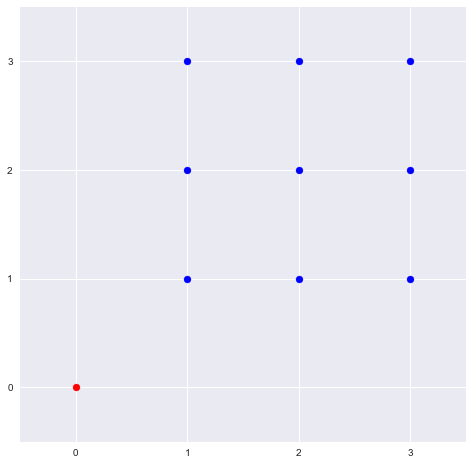

In [13]:
cities = np.array(np.meshgrid(np.arange(1,4),np.arange(1,4))).T.reshape(-1,2)
V0 = np.array ([0,0])
V  = cities[:]

plt.figure(figsize=(8,8)) 
plt.axes(xlim=(-0.5, 3.5), ylim=(-0.5, 3.5))
plt.xticks([0,1,2,3])
plt.yticks([0,1,2,3])

plt.scatter(V0[0],V0[1],c=['red'])
plt.scatter(V[:,0],V[:,1],c=['blue'])
plt.grid(True)



In [14]:
## Faites varier temperature et re-éxcuter l'algorithme 
T = 0.1 ## essayer 0.1, 0.5, 2., 5, 10. etc
x = algorithm0(V0,V,400, Temperature= T) ##

initial distance =  16.12899020449196
initial order of V =  [array([1, 1]), array([1, 2]), array([1, 3]), array([2, 1]), array([2, 2]), array([2, 3]), array([3, 1]), array([3, 2]), array([3, 3])]
[0 1 6 3 4 5 2 7 8] 	 --> 16.12899020449196
[0 1 6 3 8 5 2 7 4] 	 --> 15.950844619618655
[0 1 2 3 8 5 6 7 4] 	 --> 15.950844619618655
[0 3 2 1 8 5 6 7 4] 	 --> 15.950844619618655
[0 3 2 4 8 5 6 7 1] 	 --> 15.950844619618655
[0 3 2 4 8 7 6 5 1] 	 --> 15.36505818199175
[0 3 2 4 6 7 8 5 1] 	 --> 14.128990204491961
[0 3 1 4 6 7 8 5 2] 	 --> 13.404918347287666
[0 1 3 4 6 7 8 5 2] 	 --> 13.404918347287666
[0 1 4 3 6 7 8 5 2] 	 --> 12.576491222541474
current order of V =  [array([1, 1]), array([1, 2]), array([2, 2]), array([2, 1]), array([3, 1]), array([3, 2]), array([3, 3]), array([2, 3]), array([1, 3])]


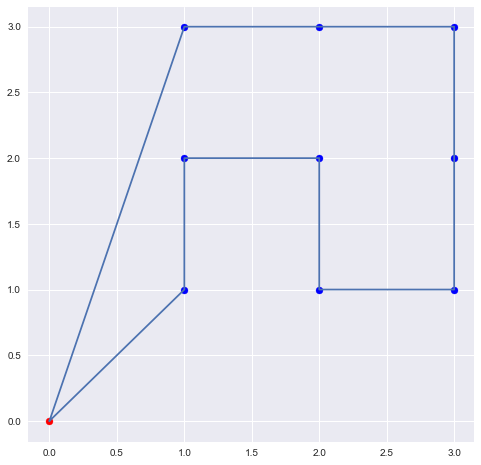

In [15]:
plt.figure(figsize=(8,8)) 

plt.scatter(V0[0],V0[1],c=['red'])
plt.scatter(V[:,0],V[:,1],c=['blue'])

W = np.vstack((V0,V[x]))
W = np.vstack((W,V0))
plt.plot(W[:,0],W[:,1])
plt.grid(True)


>### **Question**
Discuter et expérimenter les choix de température $T$.
>  - $T$  petit
>  - $T$  grand

> **Answer** T grand, plus de temperature, plus la proba de choisir une solution non optimal (sortir du local optimum) est elevé.

# III- Dynamique de $(X_n)_{n\geq0}$


On va étudier la chaîne aléatoire $(X_n)_{n\geq0}$ générée par l'algorithme décrit plus haut ($N=+\infty$) à tempéature fixée $T=\tau>0$. La chaine $(X_n)_{n\geq0}$ est une chaine de Markov, en effet le choix de $X_{n+1}$ dépends de $X_0,\dots,X_n$ que par $X_n$.

## Probabilités de transition

 On note $P_\tau$ la matrice de transition de la chaîne $(X_n)_{n\geq0}$, i.e.

$$
P_\tau (x,y) = P(X_{n+1}=y | X_n = x)
$$

> ### **Question** **???**
Donner les probabilités $P_\tau (x,y)$ pour tous $x,y \in {\cal P}_M$. Distinguer les cas
$$
y \not\in {\cal B} (x) : P_\tau (x,y) = 0,
\quad\quad\quad\quad
y \in {\cal B} (x) - \{x\} : P_\tau (x,y) = 1/ \#({\cal B}_{1}(x)),
\quad\quad\quad\quad
y=x : P_\tau (x,y) = 1/ \#({\cal B}_{1}(x)).
$$
</div>

> ### **Indication**: 
En utilisant du bon sens (sans faire des calculs compliqués), en particulier pour le cas $y \in {\cal B} (x) - \{x\}$, on suppose $x$ et $y$ fixés et on raisonne par rapport à la variable aléatoire uniforme $U_{n+1}$. On rappele que 
> - y est tiré au hasard parmi les voisins de $x$ (avec probabilité 1/num avec num nombre de voisins)
> - y est accepté (avec probabilité 1) si $f(y) < f(x)$
> - sinon y est accepté avec probabiité $ e^{- \Delta f/T}$

> Le résultat pour $y=x$ s'en déduit par la propriété que la somme des probabilités est $1$.  


> **Answer**: 

## Probabilité stationnaire de $(X_n)$ (à admettre)

La loi de Gibbs associée au "potentiel" $f$ et à la "température" $0<\tau<+\infty$ est 
définie sur ${\cal P}_M$ par 

$$
\pi_\tau (x) = \frac {1}{Z_\tau} \exp\bigg( - \frac {f(x)}\tau \bigg),
$$

où $Z_\tau$ est une constante de normalisation 

$$
{Z_\tau} = \sum_{x\in {\cal P}_M}\exp\bigg( - \frac {f(x)}\tau\bigg)
$$

En particulier $\pi_\tau$ est une loi de probabilité sur ${\cal P}_M$. En fait, $\pi_\tau$ est une mesure stationnaire (invariante) pour la chaîne $(X_n)$

$$
\pi_\tau (y) = \sum_{x\in {\cal P}_M} \pi_\tau (x) P_\tau (x,y),\quad\quad\quad \forall y \in {\cal P}_M
$$

On note que $\pi_r$ n'est pas complètement connue car $f$ n'est pas repertoriée.

La stationnarité s'interprète comme suit: La probabilité $\pi_r (x)$ est la fraction du temps que passe la chaine (X_n) à visiter l'état $x$ lorsque $n$ tend vers l'infini.

https://fr.wikipedia.org/wiki/Probabilit%C3%A9_stationnaire_d%27une_cha%C3%AEne_de_Markov?oldformat=true


## Comportements limites de $\pi_\tau$

Etant donné ${\cal P}_{M}$ l'espace des états (permutation de $\{1,\dots,M\}$), on définit ${\cal P}_M^* $ comme étant l'ensemble des minima globaux de $f$, qui est un ensemble non vide. On définit les lois $\pi_0$ et $\pi_\infty$
sur ${\cal P}_{M}$ comme étant les lois uniformes sur ${\cal P}_{M}^*$ et ${\cal P}_{M}$;  

- $\pi_0$ est la loi uniforme sur ${\cal P}_{M}^*$, i.e. 

$$
\pi_0 (x) = \frac {{\mathbf 1}_{{\cal P}_M^*} (x)}{\#({\cal P}_M^*)},\quad\quad\quad x \in {\cal P}_M.
$$

- $\pi_\infty$ est la loi uniform sur ${\cal P}_M$, i.e. 

$$
\pi_\infty (x) = \frac {1}{\#({\cal P}_M)},\quad\quad\quad x \in {\cal P}_M.
$$


> ### **Question**  **???**:  Montrer que $\pi_0$ et $\pi_\infty$ sont limites ponctuelles de $\pi_\tau$, i.e. pour tout $x\in {\cal P}_M$ 
$$
\pi_\tau (x)  \to_{\tau \to \infty} \pi_\infty (x),
\quad\quad\quad\quad
\pi_\tau (x)  \to_{\tau \to 0^+} \pi_0 (x) 
$$

</div>

> ### **Question** **???**: Donner la signification des deux convergences, en combinant la nature des lois et la stationarité, et re-éxpliquer le comportement de l'algorithme implémenté plus haut pour $T <<1$ et $T>>1$.

# Un théorème

Le recuit simulé realise une triangulation des résultat précédants.
La température initiale doit être assez grande, puis il doit décroitre lentement, d'où l'analogie avec le recuit, utilisé en métallurgie pour fabriquer un acier de bonne qualité. Une forte température initiale dispose les particules en phase liquide. Après quoi une décroissance lente de la température organise convenablement le système cristallographique solide. 


Soit maintenant une suite de températures $(\tau_n)_{n\geq0}$ tendant vers $0$, et la suite $(X_n)_{n\geq0}$ fabriquée récursivement comme dans l'algrithme avec à l'étape $n$ de l'algorithme, la température est $\tau_n$

- **Etape $n$**: à cette étape $X_n=x$. On choisit de manière aléatoire (uniforme) un voisin $y$ de $x$. On calcule la valeur de $f(y)$, et on la compare à celle de f(x)

    - si $f(y)< f(x)$, alors $y$ est meilleur que $x$, on va donc remplacer $x$ pour garder $y$, soit
  $$
  X_{n+1} = y.
  $$
    - si $f(y) \geq f(x)$, alors $x$ reste meilleur. On tire au hasard $U_{n+1}$ de loi uniforme  sur $]0,1[$ (indépendante de $y$) et on pose
  $$
  X_{n+1} =  \left\{ \begin{array}{l} y \quad\mbox{  si } f(y) \leq f(x) - \tau_{n+1} \log(U_{n+1}),\\ x \quad \mbox{  sinon}. \end{array} \right.  
  $$

Sous certaines conditions sur $(\tau_n)_{n\geq0}$, la chaîne $(X_n)_{n\geq0}$ va se concentrer sur les minima de $f$. Il existe des résultats théoriques sur les schémas de refroidissement à prendre (i.e. la vitesse de décroissance de la suite $(\tau_n)_{n\geq0}$)


## Un schémas de refroidissement 

On suppose donnée une relation de voisinage $\sim$ et la notation $\cal B(x)$ pour les voisins de $x$. On note $N_{xy}$ le nombre minimal de relations de voisinage nécessaires pour passer de $x$ à $y$. 
En particulier $N_{xx} = 0$, $N_{xy} = 1$ si $y \in B(x)$, sinon $N_{xy} = 2$ si $y \in B(y_1)$ et $y_1 \in B(x)$, etc. On a

$$
N_{xy} = 1 + \inf \{n\geq1 \mbox{ tel que }  y_1 \in B(x), y_2 \in B(y_1),\dots, y \in B(y_{n})\}
$$

Le nombre $N_{xy}$ est la valeur du plus court chemin reliant $x$ à y en termes de voisinage. On définit par la suite les notations suivantes

- On note $N_{\rm max}$ le plus grand de ces nombres

$$
N_{\rm max} = \max \{N_{xy}: x\in \cal P_M, y\in \cal P_M\}.
$$

- On note $\Delta_{\rm max}$ la plus grande marche entre deux voisins:

$$
\Delta_{\rm max} = \max \{f (x) - f (y) : x\in \cal P, y\in B(x) \}.
$$

- On définit la quantité $\gamma_{\rm max}$ par $\gamma_{\rm max} = N_{\rm max} \times \Delta_{\rm max} $ 


> ### **Théorème**:
Si la suite $(\tau_n)_{n\geq1}$ est donné par $\tau_n = \gamma / \log(n)$ avec $\gamma > \gamma^*$, alors pour tout $x \in {\cal P}_M$, on a  
  $$
  \lim_{n\to \infty } {\mathbb P} (X_n \in {\cal P}_M^* | X_0 = x ) = 1
  $$ 

La chaîne $X_n$ va visiter les minima de $f$ la plupart du temps quand $n$ tend vers l'infini 

> ### **Question**:
Compléter l'algrithme ci-dessus 

In [16]:
## gamma comme dans le theorème
def algorithm1 (V0,V,N, gamma):
    M = len(V) 
    x = np.arange(M) ## permutation initiale (identité)
    min_dist = circuit_distance (V0, V, x) ## distance du circuit initiale
    print ("initial distance = ",min_dist)
    print ("initial order of V = ", [Vi for Vi in V[x]])
    n = 1
    while(n < N ):
        ## completer ici
        y = random_swap(x)
        new_dist = circuit_distance(V0, V, y)
        diff_dist = new_dist - min_dist
        Tn = gamma/np.log(n)
        if diff_dist < 0 or diff_dist <= -Tn*np.log(np.random.uniform()) : ## compléter ici 
            x=y
            min_dist = new_dist 
            print (x,"\t -->",min_dist)        
        n = n+1

    print ("current distance = ",min_dist)     
    print ("current order of V = ", [Vi for Vi in V[x]])
    return x

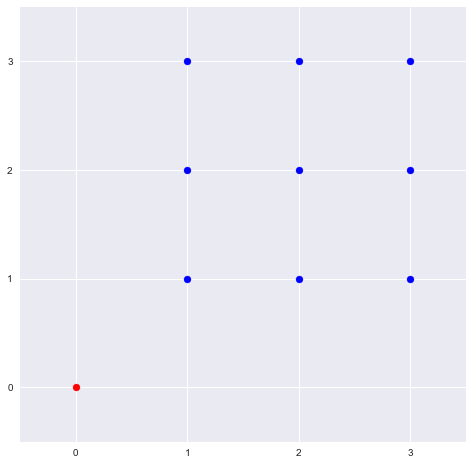

In [17]:
cities = np.array(np.meshgrid(np.arange(1,4),np.arange(1,4))).T.reshape(-1,2)
V0 = np.array ([0,0])
V  = cities[:]

plt.figure(figsize=(8,8)) 
plt.axes(xlim=(-0.5, 3.5), ylim=(-0.5, 3.5))
plt.xticks([0,1,2,3])
plt.yticks([0,1,2,3])

plt.scatter(V0[0],V0[1],c=['red'])
plt.scatter(V[:,0],V[:,1],c=['blue'])
plt.grid(True)

In [18]:
## distance optimale 12.06
## Faites varier gamma et re-éxcuter l'algorithme 
## on constate convergences avec N = 150 et gamma =1  // et avec  N = 5000 et gamma =2
x = algorithm1 (V0,V,N=5000, gamma= 2.) ##

initial distance =  16.12899020449196
initial order of V =  [array([1, 1]), array([1, 2]), array([1, 3]), array([2, 1]), array([2, 2]), array([2, 3]), array([3, 1]), array([3, 2]), array([3, 3])]
[0 1 5 3 4 2 6 7 8] 	 --> 17.31370849898476
[0 1 3 5 4 2 6 7 8] 	 --> 17.31370849898476
[0 1 2 5 4 3 6 7 8] 	 --> 13.65685424949238
[0 1 8 5 4 3 6 7 2] 	 --> 15.048627177541054
[0 1 2 5 4 3 6 7 8] 	 --> 13.65685424949238
[0 1 2 4 5 3 6 7 8] 	 --> 15.071067811865476
[0 1 4 2 5 3 6 7 8] 	 --> 15.071067811865476
[0 1 4 2 5 8 6 7 3] 	 --> 13.478708664619075
[0 3 4 2 5 8 6 7 1] 	 --> 14.06449510224598
[0 3 4 8 5 2 6 7 1] 	 --> 14.89292222699217
[0 3 4 6 5 2 8 7 1] 	 --> 15.30056307974577
[0 3 4 6 7 2 8 5 1] 	 --> 14.714776642118865
[0 3 4 6 7 2 5 8 1] 	 --> 14.53663105724556
[0 3 4 6 7 8 5 2 1] 	 --> 12.06449510224598
[0 3 6 4 7 8 5 2 1] 	 --> 12.06449510224598
[0 3 6 4 8 7 5 2 1] 	 --> 12.892922226992171
[0 3 6 4 7 8 5 2 1] 	 --> 12.06449510224598
[0 3 6 7 4 8 5 2 1] 	 --> 12.06449510224598
[0 3 6

C:\Users\taoufik.elkhiraoui\Anaconda3\envs\optimization\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  


[0 3 4 6 7 8 5 2 1] 	 --> 12.06449510224598
[0 3 6 4 7 8 5 2 1] 	 --> 12.06449510224598
[0 3 6 8 7 4 5 2 1] 	 --> 12.650281539872886
[0 3 6 8 4 7 5 2 1] 	 --> 13.478708664619075
[0 3 6 8 5 7 4 2 1] 	 --> 13.478708664619077
[0 3 6 4 5 7 8 2 1] 	 --> 13.478708664619075
[0 3 6 4 7 5 8 2 1] 	 --> 13.478708664619075
[0 3 6 4 2 5 8 7 1] 	 --> 13.478708664619075
[0 3 7 4 2 5 8 6 1] 	 --> 14.714776642118865
[0 1 7 4 2 5 8 6 3] 	 --> 14.06449510224598
[0 1 7 8 2 5 4 6 3] 	 --> 14.064495102245981
[0 1 4 8 2 5 7 6 3] 	 --> 13.478708664619075
[0 1 4 8 5 2 7 6 3] 	 --> 13.30056307974577
[0 1 2 8 5 4 7 6 3] 	 --> 12.650281539872886
[0 1 2 4 5 8 7 6 3] 	 --> 12.06449510224598
[0 1 2 5 4 8 7 6 3] 	 --> 12.06449510224598
[0 1 2 4 5 8 7 6 3] 	 --> 12.06449510224598
[0 1 4 2 5 8 7 6 3] 	 --> 12.06449510224598
[0 4 1 2 5 8 7 6 3] 	 --> 12.06449510224598
[0 1 4 2 5 8 7 6 3] 	 --> 12.06449510224598
[0 1 2 4 5 8 7 6 3] 	 --> 12.06449510224598
[0 1 2 5 4 8 7 6 3] 	 --> 12.06449510224598
[0 1 2 5 8 4 7 6 3] 	 

## Animation: Circuit optimal  

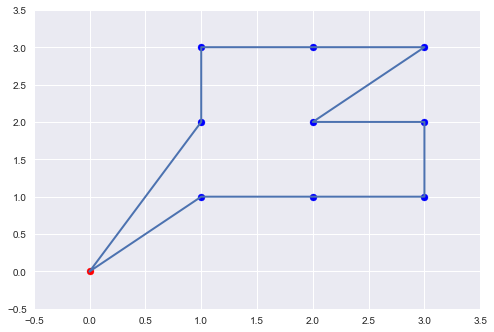

In [19]:
from IPython.display import HTML
from matplotlib import animation,rc

W = np.vstack((V0,V[x]))
W = np.vstack((W,V0))

xmin = np.min (W[:,0]) - 0.5
xmax = np.max (W[:,0]) + 0.5
ymin = np.min (W[:,1]) - 0.5
ymax = np.max (W[:,1]) + 0.5

num_frame = len(W)


# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure()
ax = plt.axes(xlim=(xmin, xmax), ylim=(ymin, xmax))
line, = ax.plot([], [], lw=2)
plt.grid(True)

plt.scatter(V0[0],V0[1], c=['red'])
for Vi in V:
    plt.scatter(Vi[0],Vi[1],c=['blue'])

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(i):
    line.set_data(W[:i+1,0],W[:i+1,1])
    return line,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,frames=num_frame, interval=500,repeat=True,blit=True)

# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
anim

#plt.show()


> ### **Question** :
- écrire un algorithme qui stocke et renvoie tous les $X_n$ de la chaîne, ($X_0$ et $X_n$ calculés dans l'itération) c-à-d $[X_0,X_1,...X_{N-1}]$.
- utiliser le résutat de cet algorithme pour créer une animation de l'évolultion de la recherche par recuit simulé. 
- éxecuter et animer l'algorithme pour 25 villes placé sur une grille carrée $5 \times 5$, $ \{1,2,3,4,5\} \times \{1,2,3,4,5\}$ avec $V_0$ placé en $(1,1)$ et $V_1,\dots,V_{24}$ les autres villes.


### Algo simulated Annealing with decaying Temperature

In [20]:
## gamma comme dans le theorème
def algorithm2(V0,V,N, gamma):
    M = len(V) 
    x = np.arange(M) ## permutation initiale (identité)
    min_dist = circuit_distance (V0, V, x) ## distance du circuit initiale
    print ("initial distance = ",min_dist)
    print ("initial order of V = ", [Vi for Vi in V[x]])
    n = 1
    X_list = []
    while(n < N ):
        ## completer ici
        y = random_swap(x)
        new_dist = circuit_distance(V0, V, y)
        diff_dist = new_dist - min_dist
        U = np.random.uniform(0.0001)
        Tn = gamma/np.log(n)
        if diff_dist < 0 or diff_dist <= -Tn*np.log(U) : ## compléter ici 
            x=y
            min_dist = new_dist 
            print (x,"\t -->",min_dist)
            X_list.append(x)
        n = n+1
        

    print ("current distance = ",min_dist)     
    print ("current order of V = ", [Vi for Vi in V[x]])
    return x, X_list

In [21]:
import timeit
starttime = timeit.default_timer()
x, X_list = algorithm2(V0,V,N=5000, gamma= 2.)
print("took (in s): ", timeit.default_timer() - starttime)

initial distance =  16.12899020449196
initial order of V =  [array([1, 1]), array([1, 2]), array([1, 3]), array([2, 1]), array([2, 2]), array([2, 3]), array([3, 1]), array([3, 2]), array([3, 3])]
[3 1 2 0 4 5 6 7 8] 	 --> 17.543203766865055
[7 1 2 0 4 5 6 3 8] 	 --> 20.734541479955947
[7 1 3 0 4 5 6 2 8] 	 --> 21.74111418957545
[7 1 6 0 4 5 3 2 8] 	 --> 22.734541479955947
[7 1 5 0 4 6 3 2 8] 	 --> 21.56296860470214
[7 1 4 0 5 6 3 2 8] 	 --> 21.97060945745574
[7 1 4 5 0 6 3 2 8] 	 --> 21.320327917582855
[7 1 5 4 0 6 3 2 8] 	 --> 20.912687064829253
[7 1 5 4 2 6 3 0 8] 	 --> 21.333473336821847
[1 7 5 4 2 6 3 0 8] 	 --> 19.963990038857645
[1 7 5 2 4 6 3 0 8] 	 --> 18.549776476484553
[4 7 5 2 1 6 3 0 8] 	 --> 18.549776476484553
[4 7 5 2 1 6 8 0 3] 	 --> 17.543203766865055
[4 7 0 2 1 6 8 5 3] 	 --> 18.536631057245557
[4 5 0 2 1 6 8 7 3] 	 --> 17.950844619618653
[4 2 0 5 1 6 8 7 3] 	 --> 18.779271744364845
[4 2 0 5 1 3 8 7 6] 	 --> 18.705481427033437
[4 0 2 5 1 3 8 7 6] 	 --> 17.4694134495336

C:\Users\taoufik.elkhiraoui\Anaconda3\envs\optimization\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in double_scalars
  app.launch_new_instance()


[0 1 2 5 8 7 4 6 3] 	 --> 12.064495102245981
[0 1 2 5 8 7 4 3 6] 	 --> 12.576491222541474
[0 1 2 5 8 7 6 3 4] 	 --> 12.242640687119286
[4 1 2 5 8 7 6 3 0] 	 --> 12.242640687119286
[4 5 2 1 8 7 6 3 0] 	 --> 13.478708664619075
[1 5 2 4 8 7 6 3 0] 	 --> 12.89292222699217
[4 5 2 1 8 7 6 3 0] 	 --> 13.478708664619075
[8 5 2 1 4 7 6 3 0] 	 --> 13.65685424949238
[1 5 2 8 4 7 6 3 0] 	 --> 13.478708664619075
[1 5 2 8 7 4 6 3 0] 	 --> 13.478708664619075
[1 5 2 8 4 7 6 3 0] 	 --> 13.478708664619075
[1 5 8 2 4 7 6 3 0] 	 --> 13.478708664619075
[1 5 4 2 8 7 6 3 0] 	 --> 13.478708664619074
[1 4 5 2 8 7 6 3 0] 	 --> 12.650281539872886
[1 5 4 2 8 7 6 3 0] 	 --> 13.478708664619074
[1 5 8 2 4 7 6 3 0] 	 --> 13.478708664619075
[1 2 8 5 4 7 6 3 0] 	 --> 12.650281539872886
[1 2 4 5 8 7 6 3 0] 	 --> 12.06449510224598
[2 1 4 5 8 7 6 3 0] 	 --> 12.576491222541474
[4 1 2 5 8 7 6 3 0] 	 --> 12.242640687119286
[1 4 2 5 8 7 6 3 0] 	 --> 12.06449510224598
[1 2 4 5 8 7 6 3 0] 	 --> 12.06449510224598
[1 4 2 5 8 7 6 

## Animation

In [22]:
from IPython.display import HTML
from matplotlib import animation,rc

def generate_animation(V0, V, X_list):
    W_list = []
    for x in X_list:
        W = np.vstack((V0,V[x]))
        W = np.vstack((W,V0))
        W_list.append(W)
    
    xmin = np.min(W_list[0][:,0]) - 0.5
    xmax = np.max(W_list[0][:,0]) + 0.5
    ymin = np.min(W_list[0][:,1]) - 0.5
    ymax = np.max(W_list[0][:,1]) + 0.5
    
    num_frame = len(W_list)
    
    # First set up the figure, the axis, and the plot element we want to animate
    fig = plt.figure()
    ax = plt.axes(xlim=(xmin, xmax), ylim=(ymin, xmax))
    line, = ax.plot([], [], lw=2)
    plt.grid(True)
    
    plt.scatter(V0[0],V0[1], c=['red'])
    for Vi in V:
        plt.scatter(Vi[0],Vi[1],c=['blue'])
    
    # initialization function: plot the background of each frame
    def init():
        line.set_data([], [])
        return line,
    
    # animation function.  This is called sequentially
    def animate(i):
        line.set_data(W_list[i][:,0],W_list[i][:,1])
        return line,
    
    # call the animator.  blit=True means only re-draw the parts that have changed.
    anim = animation.FuncAnimation(fig, animate, init_func=init,frames=num_frame, interval=500,repeat=True,blit=True)
    
    # Note: below is the part which makes it work on Colab
    rc('animation', html='jshtml')
    rc('animation', embed_limit = 200)
    return anim


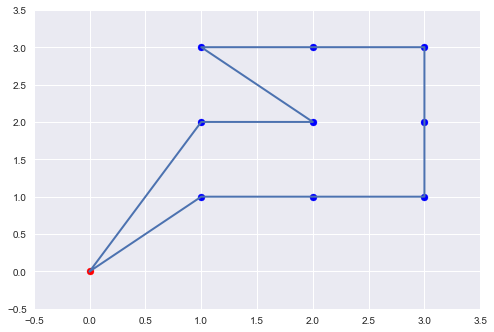

In [23]:
anim = generate_animation(V0, V, X_list)
anim

In [24]:
#!pip install pillow
writer = animation.PillowWriter(fps=100) 
anim.save("TSP_10_cities.gif", writer=writer)

## Simulation with 25 cities

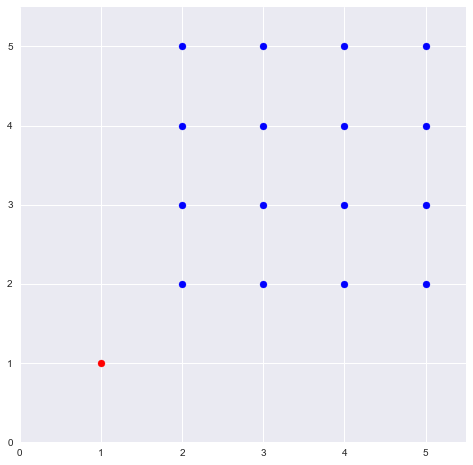

In [25]:
cities = np.array(np.meshgrid(np.arange(2,6),np.arange(2,6))).T.reshape(-1,2)
V0 = np.array ([1,1])
V  = cities[:]

plt.figure(figsize=(8,8)) 
plt.axes(xlim=(0, 5.5), ylim=(0, 5.5))
plt.xticks([0,1,2,3,4,5])
plt.yticks([0,1,2,3,4,5])

plt.scatter(V0[0],V0[1],c=['red'])
plt.scatter(V[:,0],V[:,1],c=['blue'])
plt.grid(True)


In [26]:
import timeit
starttime = timeit.default_timer()
x, X_list = algorithm2(V0,V,N=50000, gamma= 2.)
print("took (in s): ", timeit.default_timer() - starttime)

initial distance =  28.55790079237061
initial order of V =  [array([2, 2]), array([2, 3]), array([2, 4]), array([2, 5]), array([3, 2]), array([3, 3]), array([3, 4]), array([3, 5]), array([4, 2]), array([4, 3]), array([4, 4]), array([4, 5]), array([5, 2]), array([5, 3]), array([5, 4]), array([5, 5])]
[ 0  1  2  3  4  5  6  7  8 15 10 11 12 13 14  9] 	 --> 29.49730260325679
[ 0  1  2  8  4  5  6  7  3 15 10 11 12 13 14  9] 	 --> 26.838896747497845
[ 0  1  2 11  4  5  6  7  3 15 10  8 12 13 14  9] 	 --> 27.246537600251443
[ 0  1  2 14  4  5  6  7  3 15 10  8 12 13 11  9] 	 --> 29.498473502456157
[ 0  1  2 14  4  5  6  7  3 15 10  9 12 13 11  8] 	 --> 29.469413449533644
[ 0  1  2 12  4  5  6  7  3 15 10  9 14 13 11  8] 	 --> 29.246537600251447
[ 0  1  2 12  4  5  6  7  3 15 10 14  9 13 11  8] 	 --> 29.246537600251447
[ 0  1  2 12  4  5  6  7  3 15 10 13  9 14 11  8] 	 --> 28.83889674749785
[ 0  1  2 12  4  8  6  7  3 15 10 13  9 14 11  5] 	 --> 28.977182167075238
[ 0  1  2 10  4  8  6  7  

C:\Users\taoufik.elkhiraoui\Anaconda3\envs\optimization\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in double_scalars
  app.launch_new_instance()


[ 0  3  2  5  4  8 12 13  9 10 14 15 11  7  6  1] 	 --> 21.478708664619074
[ 0  1  2  5  4  8 12 13  9 10 14 15 11  7  6  3] 	 --> 21.36574631273695
[ 0  1  6  5  4  8 12 13  9 10 14 15 11  7  2  3] 	 --> 21.365746312736945
[ 0  1  6  5  4  8 12 13  9 10 14 15 11  7  3  2] 	 --> 19.99070478491457
[ 0  5  6  1  4  8 12 13  9 10 14 15 11  7  3  2] 	 --> 20.81913190966076
[ 0  1  6  5  4  8 12 13  9 10 14 15 11  7  3  2] 	 --> 19.99070478491457
[ 0  1  6  5  4  8 12 13  9 14 10 15 11  7  3  2] 	 --> 20.81913190966076
[ 0  1  6  5  4  8 12 13  9 14 15 10 11  7  3  2] 	 --> 20.81913190966076
[ 0  2  6  5  4  8 12 13  9 14 15 10 11  7  3  1] 	 --> 21.478708664619077
[ 0  2  3  5  4  8 12 13  9 14 15 10 11  7  6  1] 	 --> 22.128990204491963
[ 0  2  3  5  4  8 12 13  9 14 15 11 10  7  6  1] 	 --> 22.128990204491963
[ 0  2  3  5  4  8 12  9 13 14 15 11 10  7  6  1] 	 --> 22.128990204491963
[ 0  2  3  5  4  8 12  9 13 14 15 11  7 10  6  1] 	 --> 22.128990204491963
[ 0  2  3  5  4  8 12  9 13 14 

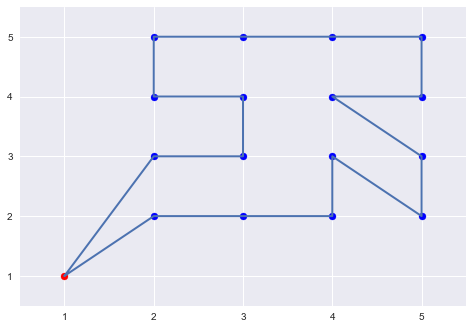

In [27]:
anim = generate_animation(V0, V, X_list)
anim

In [28]:
writer = animation.PillowWriter(fps=100)
anim.save("TSP_25_cities.gif", writer=writer)

# Autres Références 

Promenade aléatoire: Chaînes de Markov et simulations : martingales et stratégie. (Michel Benaïm/ Nicole EL KAROUI)

https://www.amazon.com/Promenade-al%C3%83%C2%A9atoire-French-Edition/dp/2730211683

Cooling schedules for optimal annealing (Bruce Hajek)

https://pubsonline.informs.org/doi/abs/10.1287/moor.13.2.311



#Fin du projet

Quelques méthodes de résolution


- https://www.geeksforgeeks.org/traveling-salesman-problem-using-branch-and-bound-2/

- https://towardsdatascience.com/how-to-solve-the-traveling-salesman-problem-a-comparative-analysis-39056a916c9f


# Bonus 



## Voisinage : stratégies 3 et 4 

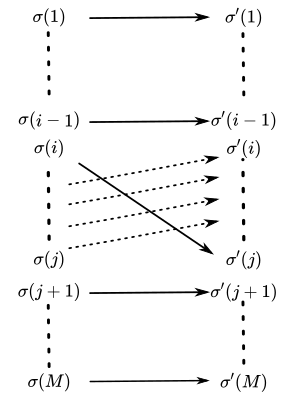

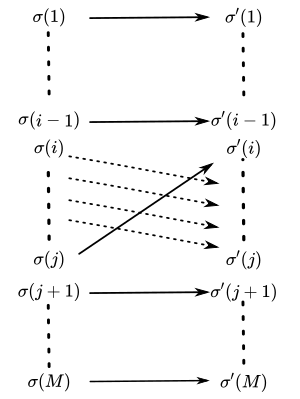

> ### **Question** 
écrire les fonctions "translate_left" et "translate_right" qui performent les transformation des strategies 3 et 4?

In [29]:
def translate_left(x,i,j):
    ## assert i and j are valid indices, i.e. in {0,1,...,n-1}
    M = len(x)
    assert (i in range(M) and j in range(M)) 
    if j<i: 
        translate_left(x,j,i)
        return
    ## translate x[i+1]... x[j] to left and move x[i] to position j  
    x[i:j] , x[j] = x[i+1:j+1], x[i] ## Completer 

def translate_right(x,i,j):
    ## assert i and j are valid indices, i.e. in {0,1,...,n-1}
    M = len(x)
    assert (i in range(M) and j in range(M))
    if j<i: 
        translate_right (x,j,i)
        return
    ## translate x[i]... x[j-1] to right and move x[j] to position i
    x[i+1:j+1] , x[i] = x[i:j] , x[j] ## compléter


def translate_left_copy(x,i,j):
    y = np.copy(x)
    translate_left(y,i,j)
    return y

def translate_right_copy(x,i,j):
    y = np.copy(x)
    translate_right(y,i,j)
    return y

def random_translate_left(x):
    M = len(x)
    i = np.random.randint(0, M) ## chosir aleatoirement i 
    j = np.random.randint(0, M) ## chosir aleatoirement j, ne par tirer j=i
    while i == j:
        j = np.random.randint(0, M)
    return translate_left_copy(x,i,j)

def random_translate_right(x):
    M = len(x)
    i = np.random.randint(0, M) ## chosir aleatoirement i 
    j = np.random.randint(0, M) ## chosir aleatoirement j, ne par tirer j=i
    while i == j:
        j = np.random.randint(0, M)
    return translate_right_copy(x,i,j)
     

In [30]:
x = [1,3,4,5,7,6,8]
translate_left(x,2,4) 
print ('expected result', [1, 3, 5, 7, 4, 6, 8] )
print ('returned result', x )


expected result [1, 3, 5, 7, 4, 6, 8]
returned result [1, 3, 5, 7, 4, 6, 8]


In [31]:
x = [1,3,4,5,7,6,8]
translate_right (x,2,4)
print ('expected result', [1, 3, 7, 4, 5, 6, 8] )
print ('returned result', x )

expected result [1, 3, 7, 4, 5, 6, 8]
returned result [1, 3, 7, 4, 5, 6, 8]


In [32]:
## gamma comme dans le theorème
def algorithm3(V0,V,N, gamma, strategy_num):
    assert (strategy_num in range(1,5))
    M = len(V) 
    x = np.arange(M) ## permutation initiale (identité)
    min_dist = circuit_distance (V0, V, x) ## distance du circuit initiale
    print ("initial distance = ",min_dist)
    print ("initial order of V = ", [Vi for Vi in V[x]])
    n = 1
    X_list = []
    if strategy_num == 1:
        strategy_func = random_swap
    elif strategy_num == 2:
        strategy_func = random_reverse
    elif strategy_num == 3:
        strategy_func = random_translate_left
    else :
        strategy_func = random_translate_right
        
    while(n < N ):
        ## completer ici
        y = strategy_func(x)
        new_dist = circuit_distance(V0, V, y)
        diff_dist = new_dist - min_dist
        U = np.random.uniform(0.00001)
        Tn = gamma/np.log(n)
        if diff_dist < 0 or diff_dist <= -Tn*np.log(U) : ## compléter ici 
            x=y
            min_dist = new_dist 
            print (x,"\t -->",min_dist)        
            X_list.append(x)
        n = n+1

    print ("current distance = ",min_dist)     
    print ("current order of V = ", [Vi for Vi in V[x]])
    return x, X_list

In [33]:
import timeit
starttime = timeit.default_timer()
x, X_list = algorithm3(V0,V,N=50000, gamma= 2., strategy_num=3)
print("took (in s): ", timeit.default_timer() - starttime)

initial distance =  28.55790079237061
initial order of V =  [array([2, 2]), array([2, 3]), array([2, 4]), array([2, 5]), array([3, 2]), array([3, 3]), array([3, 4]), array([3, 5]), array([4, 2]), array([4, 3]), array([4, 4]), array([4, 5]), array([5, 2]), array([5, 3]), array([5, 4]), array([5, 5])]
[ 0  2  3  4  5  6  7  1  8  9 10 11 12 13 14 15] 	 --> 29.86775908720181
[ 0  2  3  4  5  6  7  1  8  9 10 12 13 14 11 15] 	 --> 29.35576296690632
[ 0  2  3  5  6  7  1  8  9 10 12 13 14 11 15  4] 	 --> 27.61431828770913
[ 0  2  3  5  6  7  1  8  9 10 12 13 14 15 11  4] 	 --> 26.756831110040423
[ 0  2  3  5  7  6  1  8  9 10 12 13 14 15 11  4] 	 --> 26.93497669491373
[ 0  3  5  7  6  2  1  8  9 10 12 13 14 15 11  4] 	 --> 27.520763132540633
[ 0  3  7  6  2  1  8  9 10 12 13  5 14 15 11  4] 	 --> 27.520763132540633
[ 0  3  7  6  2  1  8  9 10 13 12  5 14 15 11  4] 	 --> 26.93497669491373
[ 0  7  6  3  2  1  8  9 10 13 12  5 14 15 11  4] 	 --> 27.511467917455203
[ 7  6  3  2  1  0  8  9 10 1

C:\Users\taoufik.elkhiraoui\Anaconda3\envs\optimization\lib\site-packages\ipykernel_launcher.py:26: RuntimeWarning: divide by zero encountered in double_scalars


[12 13 14 15 11 10  9  8  4  2  3  7  6  5  1  0] 	 --> 21.773387165490547
[13 14 15 11 10  9 12  8  4  2  3  7  6  5  1  0] 	 --> 22.53663105724556
[14 15 11 10  9 13 12  8  4  2  3  7  6  5  1  0] 	 --> 22.650281539872886
[14 15 11 10 13 12  8  4  9  2  3  7  6  5  1  0] 	 --> 23.478708664619077
[14 15 11 10 13 12  8  9  2  3  7  6  5  1  0  4] 	 --> 23.886349517372675
[14 15 10 13 12  8  9  2  3  7 11  6  5  1  0  4] 	 --> 24.714776642118867
[14 15 10 13 12  8  9  2  3 11  7  6  5  1  0  4] 	 --> 25.30056307974577
[14 15 13 12  8  9 10  2  3 11  7  6  5  1  0  4] 	 --> 25.23606797749979
[14 15 13 12  8  9 10  3 11  7  6  5  1  2  0  4] 	 --> 26.47213595499958
[14 15 13 12  8  9 10 11  7  6  3  5  1  2  0  4] 	 --> 25.886349517372675
[14 15 13 12  8  9 10 11  7  6  3  5  2  1  0  4] 	 --> 25.30056307974577
[14 15 13 12  8  9 10 11  7  3  5  2  6  1  0  4] 	 --> 25.30056307974577
[14 15 13 12  8  9 10 11  7  3  5  6  1  2  0  4] 	 --> 25.886349517372675
[14 15 13 12  8  9 10 11  7  3 

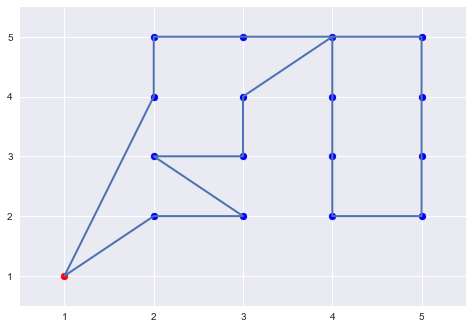

In [34]:
anim = generate_animation(V0, V, X_list)
anim

## compare the 4 strategies for the same N and Temperature : runing time wise and optimiality of solution

## Heuristiques de Christophide

https://www.wikiwand.com/fr/Algorithme_de_Christofides

On pourait implémenter cette heuristique qui est $\frac{3}{2}$-OPT c-à-d donnant un circuit de distance totale inférieur à $3/2$ la distance optimale. Cette heuristique à une complexité cubique. Une modélisation du problème avec les graphes ou tout simplement avec la donnée de la matrice d'adjascence (matrice des distances entre villes) est plus appropriée dans ca cas.

Une implémentation possible 

https://pypi.org/project/Christofides/

(pas de garantie si le code est correcte !!)

Voir aussi Algorithme Glouton de Kruskal

https://fr.wikipedia.org/wiki/Algorithme_de_Kruskal?oldformat=true

Voir NetworkX

https://networkx.org/


In [35]:
#!pip install networkx
#!pip install Christofides

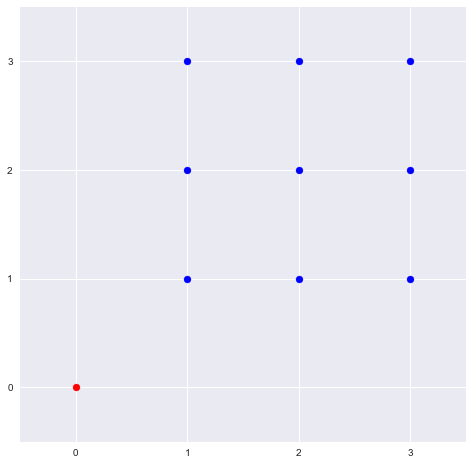

In [40]:
cities = np.array(np.meshgrid(np.arange(1,4),np.arange(1,4))).T.reshape(-1,2)
V0 = np.array ([0,0])
V  = cities[:]

plt.figure(figsize=(8,8)) 
plt.axes(xlim=(-0.5, 3.5), ylim=(-0.5, 3.5))
plt.xticks([0,1,2,3])
plt.yticks([0,1,2,3])

plt.scatter(V0[0],V0[1],c=['red'])
plt.scatter(V[:,0],V[:,1],c=['blue'])
plt.grid(True)

In [71]:
W = np.vstack((V0,V))
distance_matrix = np.empty([0, len(W)])
for point1 in W:
    row=[]
    for point2 in W:
        row.append(np.linalg.norm(point1-point2))  
    distance_matrix = np.append(distance_matrix, np.array(row).reshape(1,10), axis=0)

In [70]:
distance_matrix

array([[0.        , 1.41421356, 2.23606798, 3.16227766, 2.23606798,
        2.82842712, 3.60555128, 3.16227766, 3.60555128, 4.24264069],
       [1.41421356, 0.        , 1.        , 2.        , 1.        ,
        1.41421356, 2.23606798, 2.        , 2.23606798, 2.82842712],
       [2.23606798, 1.        , 0.        , 1.        , 1.41421356,
        1.        , 1.41421356, 2.23606798, 2.        , 2.23606798],
       [3.16227766, 2.        , 1.        , 0.        , 2.23606798,
        1.41421356, 1.        , 2.82842712, 2.23606798, 2.        ],
       [2.23606798, 1.        , 1.41421356, 2.23606798, 0.        ,
        1.        , 2.        , 1.        , 1.41421356, 2.23606798],
       [2.82842712, 1.41421356, 1.        , 1.41421356, 1.        ,
        0.        , 1.        , 1.41421356, 1.        , 1.41421356],
       [3.60555128, 2.23606798, 1.41421356, 1.        , 2.        ,
        1.        , 0.        , 2.23606798, 1.41421356, 1.        ],
       [3.16227766, 2.        , 2.2360679

took (in s):  0.006038099999841506


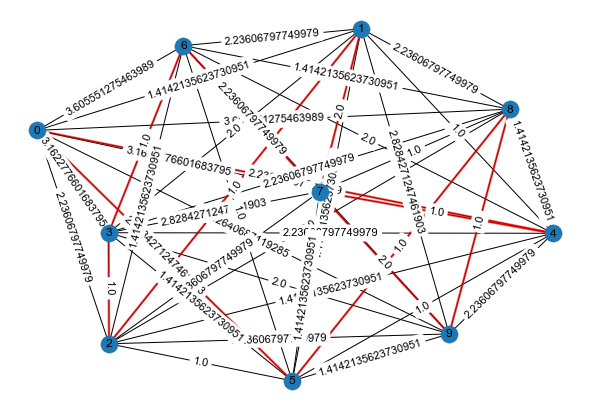

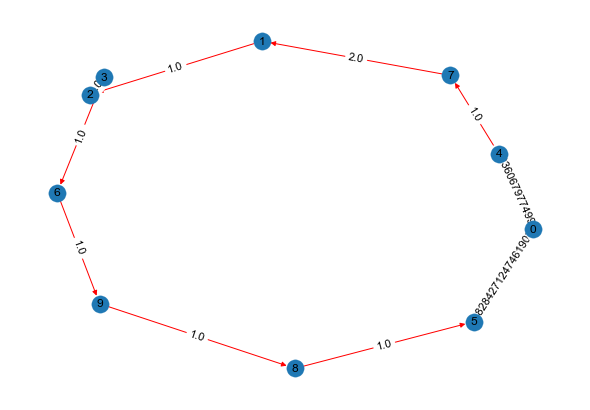

14.06449510224598


In [72]:
import networkx as nx
import christofedes
import numpy as np
import timeit
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn')
sq = np.sqrt

def CreateGraph():
    G = nx.Graph()
    n = distance_matrix.shape[0] 
    #Adds egdes along with their weights to the graph 
    for i in range(n) :
        for j in range(n)[i:] :
            if distance_matrix[i][j] > 0 :
                G.add_edge(i, j, length = distance_matrix[i][j]) 
    return G

def DrawGraph(G,color):
    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels = True, edge_color = color)  #with_labels=true is to show the node number in the output graph
    edge_labels = nx.get_edge_attributes(G,'length')
    nx.draw_networkx_edge_labels(G, pos, edge_labels = edge_labels,  font_size = 11) #prints weight on all the edges
    return pos


G = CreateGraph()
plt.figure(1)
pos = DrawGraph(G,'black')
starttime = timeit.default_timer()
opGraph = christofedes.christofedes(G, pos)
print("took (in s): ", timeit.default_timer() - starttime)
plt.figure(2)
pos1 = DrawGraph(opGraph,'r')
plt.show()
lengths = nx.get_edge_attributes(opGraph,'length')
print(np.sum(list(lengths.values())))

christofide is very fast : 
the optimal distance given by christophide is always ander 1.5* global_optimim           
(we found previousely global optimum = '12.06449510224598', so christophide here empiricly : 
 always < 1.5*12.06449510224598 

In [39]:
1.5*12.06449510224598

18.09674265336897

### D'autres recommandations,

- Former une matrice de distance pour calcul rapide de distance
- Calcul de la distance pour y par simple modificatin de la distance pour x   

## Questions:

- Donner la valeur exacte ou estimée de $N_{max}$ pour stratégie 1
- Donner une estimation supérieure de $\Delta_{\max}$
- Implémenter les algorithmes avec un critère d'arrêt plus pertinent, par exemple, compter les fréquences du retour de f(X_n) aux valeurs prises et considérer que le minimum est la valeur qui domine ces fréquences, par exemple celle qui est caclulée plus que la moitié du temps, quand $N$ est relativement grand.